In [71]:
# importing notebook dependencies 
%matplotlib inline
import matplotlib as mlp
mlp.rcParams['figure.dpi'] = 200

# disabling warnings
import warnings
warnings.filterwarnings('ignore')

# main libraries
import os
import pandas as pd
import numpy as np

# importing vega datasets
from vega_datasets import data

# visualization libraries/modules
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style = "darkgrid", font_scale = 0.75)

# importing plotly.express
import plotly.express as px
import plotly.io as pio
pio.renderers.default = "notebook_connected"

# data modules
import prepare

from datetime import datetime
import requests

from tqdm.notebook import tqdm, trange
import time # to be used in loop iterations

# for learning & filling-in missing values
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

----
### **``Time Series: Eploration Data Analysis (EDA) Exercises``**
Do your work for this exercise in a notebook named `explore.ipynb`. Use the techniques in the lesson to explore the **store item demand** dataset and the **opsd** dataset.

For the store item demand data, you will need to choose a method of aggregating such that each observation is a unique date. For both datasets you should choose a method of splitting your data and only explore the training split.

**Note: When resampling data, use a `mean()` aggregation method.**

### Store Item Demand
Load your store item demand data using your acquire and/or prepare functions.
1. Using a human-based approach, split your dataset into train and test sets.
2. Visualize your train-test split.

Only use your train data set to perform the following tasks:

3. Resample your data and visualize it.
4. Creating a rolling (moving) average of your data and visualize it.
5. Plot the difference in sales from one day to the next.
6. Plot the % difference in sales from one day to the next.
6. Plot the % difference in sales from one week to the next.
7. Plot the % difference in sales from one month to the next.
8. Visualize an autocorrelation plot on a weekly resampling.
9. Visualize a seasonal decomposition plot on a weekly resampling.

### OPS data
Load your OPS data using your acquire and/or prepare functions.
1. Split the data, so that train contains information up to and including 2013. The remaning data should be placed in test. 

Only use the train data set to perform the following tasks:

2. Visualize your train-test split.
3. Plot the consumption, wind, and solar data on the same chart.
4. Plot only the consumption data from the year 2010. Are there any patterns you can identify? Note them in a markdown section.
5. Resample the consumption data to monthly and plot it.
6. Resample the consumption data to yearly and plot it.

#### BONUS:
7. Group the consumption data by month and create a boxplot treating the month component as a separate categorical feature.
8. Group the consumption data by weekday and create a boxplot treating the weekday component as a separate categorical feature.
9. Create a subseasonal plot by month of your consumption data. 
10. Create one or two visualizations that helps answer the follow questions: How does wind production/consumption vary within a year? How does wind production/consumption vary from year to year?
11. Create one or two visualizations that helps answer the follow questions: How does solar production/consumption vary within a year? How does solar production/consumption vary from year to year?
12. Plot a time series decomposition for your consumption data and note your takeaways.
13. Create an autocorrelation plot of a weekly resampling of the consumption data.

----

In [72]:
# importing the sales dataset

df = prepare.get_sales_df()
df.head()

df shape: (913000, 13)


,item,sale_amount,sale_date,store,item_brand,item_name,item_price,item_upc12,item_upc14,store_address,store_city,store_state,store_zipcode
0,1,13.0,"Tue, 01 Jan 2013 00:00:00 GMT",1,Riceland,Riceland American Jazmine Rice,0.84,35200264013,35200264013,12125 Alamo Ranch Pkwy,San Antonio,TX,78253
1,1,11.0,"Wed, 02 Jan 2013 00:00:00 GMT",1,Riceland,Riceland American Jazmine Rice,0.84,35200264013,35200264013,12125 Alamo Ranch Pkwy,San Antonio,TX,78253
2,1,14.0,"Thu, 03 Jan 2013 00:00:00 GMT",1,Riceland,Riceland American Jazmine Rice,0.84,35200264013,35200264013,12125 Alamo Ranch Pkwy,San Antonio,TX,78253
3,1,13.0,"Fri, 04 Jan 2013 00:00:00 GMT",1,Riceland,Riceland American Jazmine Rice,0.84,35200264013,35200264013,12125 Alamo Ranch Pkwy,San Antonio,TX,78253
4,1,10.0,"Sat, 05 Jan 2013 00:00:00 GMT",1,Riceland,Riceland American Jazmine Rice,0.84,35200264013,35200264013,12125 Alamo Ranch Pkwy,San Antonio,TX,78253


In [73]:
# cleaning the sales df

df = prepare.clean_sales_df(df)
df.head()

df shape: (913000, 13)


,item,sale_amount,store,item_brand,item_name,item_price,store_address,store_city,store_state,store_zipcode,month,month_and_day,total_sales
2013-01-01,1,13.0,1,Riceland,Riceland American Jazmine Rice,0.84,12125 Alamo Ranch Pkwy,San Antonio,TX,78253,January,Tuesday,10.92
2013-01-01,12,26.0,7,Mueller,Mueller Sport Care Basic Support Level Medium ...,8.40,12018 Perrin Beitel Rd,San Antonio,TX,78217,January,Tuesday,218.40
2013-01-01,46,27.0,7,Mama Marys,Pizza Sauce,4.65,12018 Perrin Beitel Rd,San Antonio,TX,78217,January,Tuesday,125.55
2013-01-01,12,54.0,8,Mueller,Mueller Sport Care Basic Support Level Medium ...,8.40,15000 San Pedro Ave,San Antonio,TX,78232,January,Tuesday,453.60
2013-01-01,12,35.0,9,Mueller,Mueller Sport Care Basic Support Level Medium ...,8.40,735 SW Military Dr,San Antonio,TX,78221,January,Tuesday,294.00


In [74]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 913000 entries, 2013-01-01 to 2017-12-31
Data columns (total 13 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   item           913000 non-null  object 
 1   sale_amount    913000 non-null  float64
 2   store          913000 non-null  object 
 3   item_brand     913000 non-null  object 
 4   item_name      913000 non-null  object 
 5   item_price     913000 non-null  float64
 6   store_address  913000 non-null  object 
 7   store_city     913000 non-null  object 
 8   store_state    913000 non-null  object 
 9   store_zipcode  913000 non-null  object 
 10  month          913000 non-null  object 
 11  month_and_day  913000 non-null  object 
 12  total_sales    913000 non-null  float64
dtypes: float64(3), object(10)
memory usage: 97.5+ MB


In [75]:
# let's visualize the dataset and make assessments before splitting

sales_range = print(f'{df.index.min()} to {df.index.max()}')

2013-01-01 00:00:00 to 2017-12-31 00:00:00


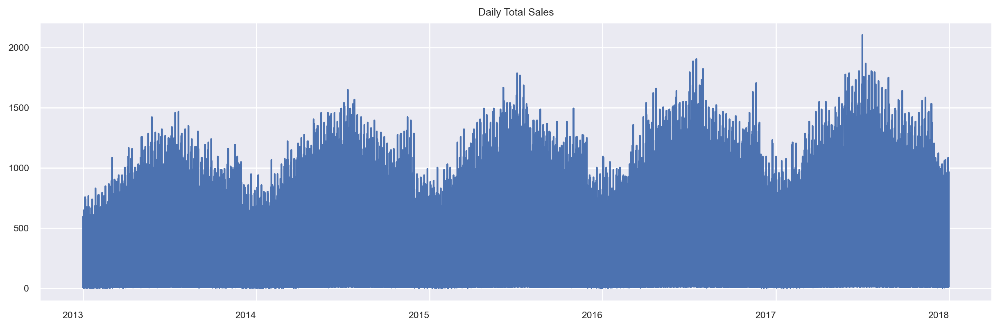

In [76]:
# let's visualize daily records

plt.figure(figsize = (15, 5))
df["total_sales"].plot()

plt.title("Daily Total Sales")
plt.xticks(rotation = 0)
plt.show()

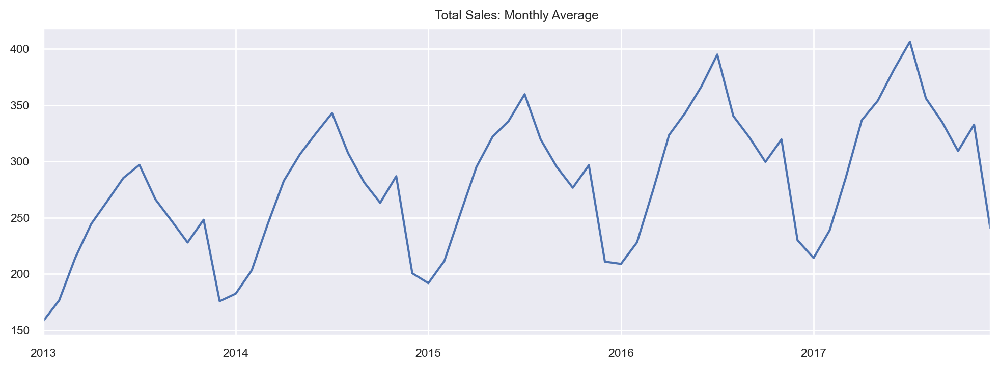

In [77]:
# let's visualize monthly total sales

plt.figure(figsize=(12, 4))

monthly_average_sales = df.resample("M").mean()
monthly_average_sales["total_sales"].plot()

plt.title("Total Sales: Monthly Average")
plt.xticks(rotation = 0)
plt.show()

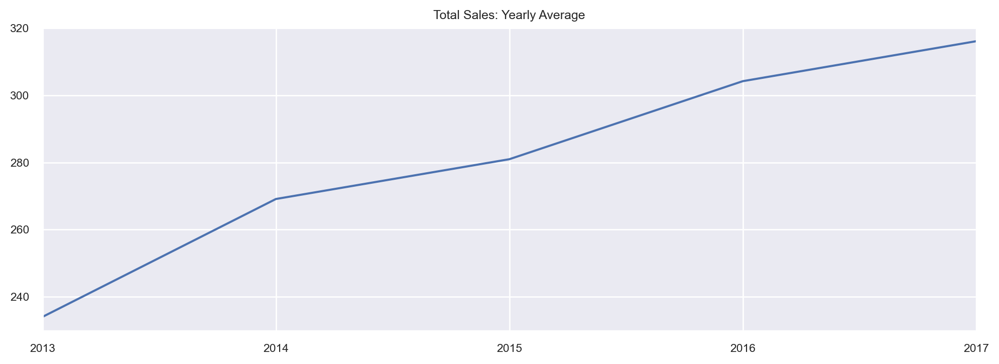

In [78]:
# let's visualize yearly average total sales

plt.figure(figsize=(12, 4))

yearly_average_sales = df.resample("Y").mean()
yearly_average_sales["total_sales"].plot()

plt.title("Total Sales: Yearly Average")
plt.xticks(rotation = 0)
plt.show()

In [79]:
# checking the shape of monthly df

monthly_average_sales.shape

(60, 3)

In [80]:
# checking the head of the df

monthly_average_sales.head()

,sale_amount,item_price,total_sales
2013-01-31,29.348645,5.1604,157.894723
2013-02-28,32.815500,5.1604,176.411855
2013-03-31,39.831097,5.1604,214.181650
2013-04-30,45.484933,5.1604,244.460082
2013-05-31,49.241419,5.1604,264.663123


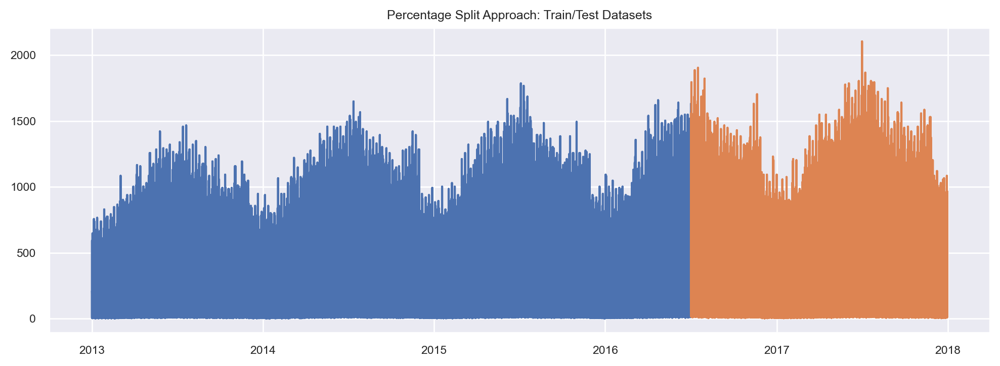

In [81]:
# what does a 70/30 split look like?

train_size = 0.70
n_records = df.shape[0]

# calculating the start/size of test
test_size = round(train_size * n_records)


train = df[:test_size] # Everything up to but not including the test_start_index
test = df[test_size:] # Everything from the test_start_index to the end


# plotting the datasets
plt.figure(figsize=(12, 4))

plt.plot(train.index, train["total_sales"])
plt.plot(test.index, test["total_sales"])

plt.title("Percentage Split Approach: Train/Test Datasets")
plt.show()

In [82]:
df.resample("B").mean().round()

,sale_amount,item_price,total_sales
2013-01-01,27.0,5.0,148.0
2013-01-02,27.0,5.0,147.0
2013-01-03,29.0,5.0,156.0
2013-01-04,33.0,5.0,177.0
2013-01-07,24.0,5.0,128.0
...,...,...,...
2017-12-25,35.0,5.0,188.0
2017-12-26,41.0,5.0,224.0
2017-12-27,41.0,5.0,218.0
2017-12-28,44.0,5.0,235.0


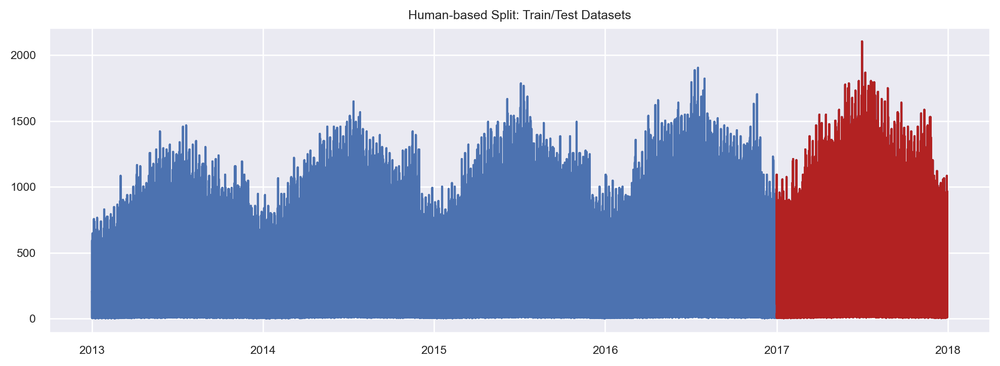

In [99]:
# human based approach
plt.figure(figsize=(12, 4))

train = df[:'2017']
test = df['2017']

# plotting the datasets
plt.plot(train.index, train["total_sales"])
plt.plot(test.index, test["total_sales"], color = 'firebrick')

plt.title("Human-based Split: Train/Test Datasets")
plt.show()

----
**``Only use your train data set to perform the following tasks:``** 
* Resample your data and visualize it.

In [84]:
# resampling and plotting sales data by month

by_month_avg = train.resample("M").mean().round()
by_month_avg.head()

,sale_amount,item_price,total_sales
2013-01-31,29.0,5.0,158.0
2013-02-28,33.0,5.0,176.0
2013-03-31,40.0,5.0,214.0
2013-04-30,45.0,5.0,244.0
2013-05-31,49.0,5.0,265.0


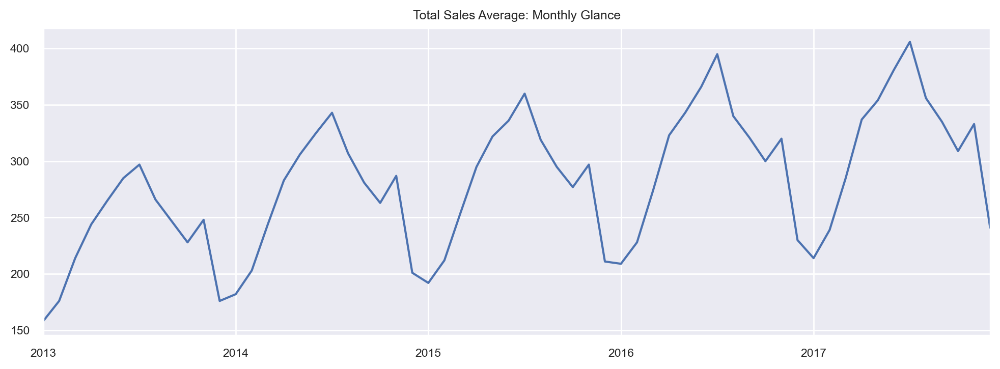

In [85]:
# plotting train data by month average
plt.figure(figsize=(12, 4))

by_month_avg["total_sales"].plot()

plt.title("Total Average Sales: Monthly Glance")
plt.show()

In [103]:
# using plotly to plot

px.line(by_month_avg["total_sales"], title="Average Monthly Sales", labels = {'index': "Date", "variable": "Legend"}, height = 500, width = 1000).show()

In [87]:
# setting a y variable

y_train = train.total_sales
y_train.head()

2013-01-01     10.92
2013-01-01    218.40
2013-01-01    125.55
2013-01-01    453.60
2013-01-01    294.00
Name: total_sales, dtype: float64

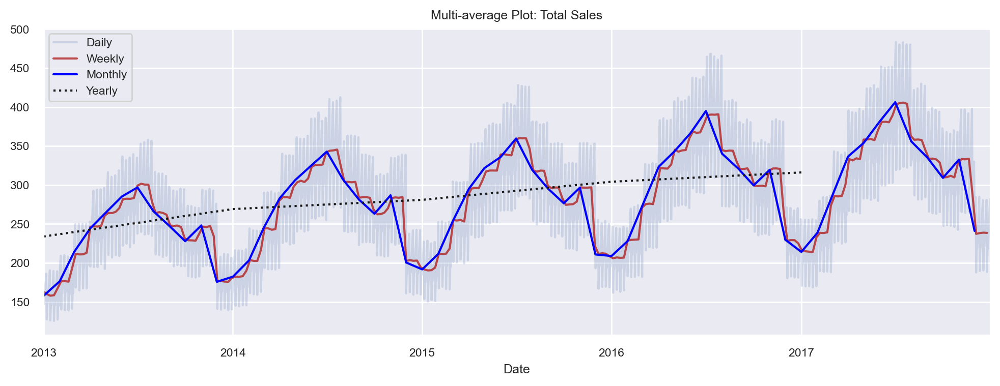

In [88]:
# multi-date total sales plotting

plt.figure(figsize=(12, 4))

y_train.resample("D").mean().plot(alpha=.2, label='Daily')
y_train.resample('W').mean().plot(alpha=.8, label='Weekly', color = 'firebrick')
y_train.resample('M').mean().plot(label='Monthly', color = 'blue')
y_train.resample('Y').mean().plot(label='Yearly', linestyle = ":", color = 'k')

plt.title("Multi-average Plot: Total Sales")
plt.xlabel("Date")
plt.xticks(rotation = 0)
plt.legend()
plt.show()

----
### ``Exercise Number 4: Creating a rolling (moving) average of your data and visualize it``


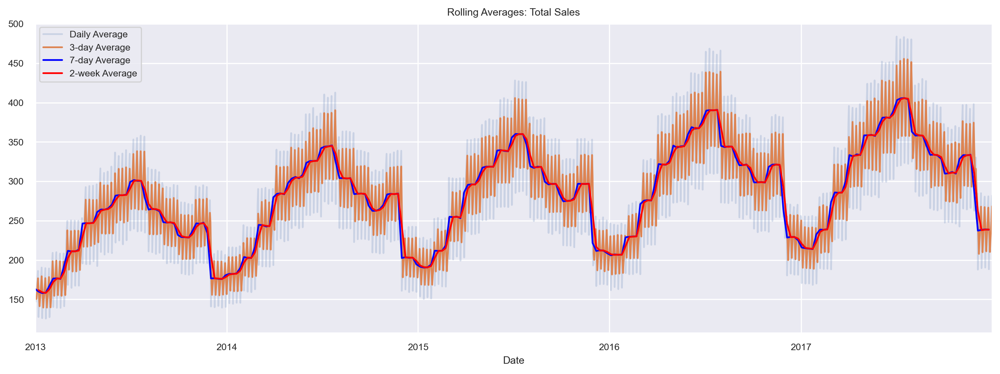

In [112]:
# setting a rolling average of the training dataset
# 3-day
# 7 days/1 week
# 2-weeks

plt.figure(figsize=(15, 5))

y_train.resample("D").mean().plot(alpha = 0.2, label = "Daily Average")
y_train.resample("D").mean().rolling(3).mean().plot(label = "3-day Average")
y_train.resample("W").mean().plot(label = "7-day Average", color = "blue")
y_train.resample("W").mean().rolling(2).mean().plot(label = "2-week Average", color = "red")

plt.title("Rolling Averages: Total Sales")
plt.xlabel("Date")
plt.legend()
plt.show()

In [110]:
# 5. Plot the difference in sales from one day to the next
# using Plotly

one_day_diff = y_train.diff()
px.line(one_day_diff, title = "1 Day Difference: Total Sales", height = 500, width = 1000, labels = {"value": "Total Value", "index": "", "variable": "total_sales"}).show()